# Imports

Some python packages, I like to use.

In [1]:
import numpy as np
import matplotlib as mpl
import matplotlib.pyplot as plt
import glob, sys, re, os, shutil, json
%load_ext autoreload
%autoreload 2

# Xplor-NIH Introduction

XPLOR-NIH is a structure determination program which builds on the X-PLOR program, including additional tools developed at the NIH. These tools include functionality for the following:
- 3J couplings
- etc.

XPLOR-NIH also includes an new internal variable module (IVM) which allows one to perform efficient molecular dynamics and minimizations using internal coordinates, such as torsion angles. The IVM permits one to do combined torsion angle/rigid body dynamics, torsion angle/cartesian coordinate dynamics, etc. We have found that a 6th order predictory-corrector integrator utilizing a time-varying, automatically time step size provides large computational advantages over the other X-PLOR dynamics engines.

## Installation

- [x] Done.

## Xplor and the globals

Some tools only work, if a pdb file has been loaded with protocol. In addition some lines of code can only be executed once. A second execution raises errors, because some of the background variables have changed.

It is very tedious to work with this kind of code, because I can not inspect the classes during their execution.

## NIH tutorial

The people at NIH call it their 'script skeleton'. This might be the framework we have to use PSolPot on.

In [18]:
import protocol

In [13]:
protocol.loadPDB("test_pdb.pdb")
from ivm import IVM
dyn = IVM()

coolParams = []

from simulationTools import AnnealIVM
coolLoop = AnnealIVM(initTemp=250, finalTemp=300, ivm=dyn, numSteps=500, tempStep=50)

def calcOneStructure(structData):
    dyn.run()
    coolLoop.run()
    dyn.run()
    
from simulationTools import StructureLoop
StructureLoop(numStructures=100, structLoopAction=calcOneStructure, doWriteStructures=True, pdbTemplate="SCRIPT_STRUCTURE.tmp").run()

averageFitSel set to: name CA


KeyboardInterrupt: 

# PSolPot

There are two PSolPot files/libraries in Xplore-NIH. `PSolPot` and `psolPotTools`.

## psolPotTools dissection

`psolPotTools` is basically redundant. It just contains some functions to construct a `PSolPot` object. But these functions can be used to see what kind of input `PSolPot` expects. Here is the code of `psolPotTools`'s `create_PSolPot` function. I added some comments to the code to make it more understandable.

```python
def create_PSolPot(name,
                   file=None,
                   restraints="",
                   tauc=0.2,
                   probeR=5.4,
                   probeC=4.0, #units? # This comment was written by the authors. Seems the unit of probe concentration is not clear.
                   fixTauc=True,
                   eSpinQuantumNumber=3.5,
                   domainSelection="known and not pseudo",
                   ):
    """Create an <m psolPot>.PSolPot with given name, given the filename of an
    PRE assignment table and/or a string of assignments.

      tauc               - correlation time
      probeR             - radius of probe molecule
      probeC             - probe concentration - units?
      fixTauc            - whether to fix the value of tauc, or to let it float
      eSpinQuantumNumber - electron sping quantum number
      domainSelection    - atoms to use in surface calculation
    """
    # Normally one would load a .pdb file and then create an AtomSelection from it.
    # These two lines create an "empty" atom selection using the string "known and not pseudo"
    from selectTools import convertToAtomSel
    domainSelection = convertToAtomSel(domainSelection)

    #set up radii
    # this whole block fills a list with predefined atomic radii
    # this block will only work, if a pdb file has been loaded previously.
    radii=[]
    for atom in domainSelection:
        if     atom.atomName()[0] == 'H': radius = 1.00
        elif   atom.atomName()[0] == 'C': radius = 1.85;
        elif   atom.atomName()[0] == 'N': radius = 1.75;
        elif   atom.atomName()[0] == 'O': radius = 1.60;
        elif   atom.atomName()[0] == 'S': radius = 2.00;
        elif   atom.atomName()[0] == 'P': radius = 2.00;
        elif   atom.atomName()[:2].upper() == 'MN': radius = 1.30
        else:
            radius=1.7
            print("WARNING: Atom " + atom.string(), end=' ')
            print(" is not supported by psolPot. radius=1.7 is used for this.")
            pass
        radii.append(radius)
        pass
    
    # the domainSelection and the radii are passed to the PSolPot class.
    # This is the correct class that can (hopefully) execute sPRE calculations.
    import psolPot
    psol = psolPot.PSolPot(name,domainSelection,radii)
    
    # Add restraints. More on that later
    if file != None:
        psol.addRestraints( open(file).read() )
        pass
    psol.addRestraints( restraints )
    
    # set some outlines of the NMR experiment? (I guess)
    #psol.setDp(0.8)  #FIX
    psol.setFixTauc(fixTauc)
    psol.setTauC( tauc )
    psol.setSqn(eSpinQuantumNumber)      # electron spin quantum number
    psol.setRho0( probeC )
    
    #psol.setVerbose(True)
    #psol.tessellation().setVerbose(True)
    psol.tessellation().setMoveTol(0.7)
    #psol.tessellation().setSavePrev(True)
    psol.setProbeRadius( probeR )

    return psol
```

## Restraints

if a file or a string of restraints has been fed into createPSolPot, the restraints are added to the instantiated PSolPot class. However, I am not sure what these restraints represent in real life. For the single Ubiquitin case they provided following restraints:

```
# GLN2 assign (resid 2	 and name HN)   0.21 0.01
# ILE3 assign (resid 3	 and name HN)   0.10 0.01
# PHE4 assign (resid 4	 and name HN)   0.09 0.01
# VAL5 assign (resid 5	 and name HN)   0.08 0.01
# LYS6 assign (resid 6	 and name HN)   0.08 0.01
# THR7 assign (resid 7	 and name HN)   0.12 0.01
# LEU8 assign (resid 8	 and name HN)   0.16 0.01
# THR9 assign (resid 9	 and name HN)   0.24 0.01
```

The documentation to these restraints reads as follows:

```
Class PSolRestraint

Accessors:

  obs    - observed solvent PRE value
  err    - error in observed solvent PRE value
  weight - per-restraint energy scale factor - this is set via the 
           pot.setCoeff method and depends on the value of pot.sclType.
           See above. [ This should be setable with pot.sclType="none", but
           isn't yet. ]
```

**What I can notice for these restraints:**

- The HN of every residue gets assigned two values (`obs`, the observed PRE value and `err` the error in the observed PRE value). For the same AA these values are not consistent THR7 and THR9 habe different values assigned to them.
- The list misses the `weight` value, the documentation talks about.

**Problem**

We want to calculate solvPRE values and compare them to our data. Is there a way to only calculate sPRE?

- [x] Test 1: Redo Gong paper and verify psolPot is working as intended.
- [x] Test 2: Provide empty string to restraints.
- [x] Test 3: Provide PRE values of single UBQ to K6-diUBQ

## Test 1: Redo Gong stuff

They put their code as a test into the Xplor-NIH code. So I will just copy their code in verbose and execute it.

```
Zhou Gong, C.D. Schwieters and Chun Tang, ``Theory and
   practice of using solvent paramagnetic relaxation enhancement
   to characterize protein conformational dynamics,'' Methods,
   148, 48-56 (2018) PMID: 29656079
 ```

In [1]:
import protocol
radius = 1.4
protocol.loadPDB("test_pdb.pdb", deleteUnknownAtoms=True)

In [2]:
from psolPotTools import create_PSolPot
psol = create_PSolPot("psol", file="test_spre.tbl")

In [3]:
psol.setRmin(0.8)
#psol.setRadMax(30.0)
#psol.setThkIni(1.0)
#psol.setThkFac(1.4)
#psol.setTcType("fix")
psol.setTauC(0.2)
#psol.setPconc(4.0)
psol.setSqn(3.5)
psol.setRho0(0.24)
psol.setScale(1.7)

psol.tessellation().setVerbose(True)

print(psol.info())
psol.setThreshold(0)
psol.setProbeRadius(radius)
psol.setRadiusOffset(radius)

print(psol.calcEnergy())

number of restraints_: 72
selection: known and not pseudo
simulation: XplorSimulation
threshold: 0.1
potential type: PSol
target type: gamma
 scale = 1.7
 hardExp = 2
 rSwitch = 10
 softExp = 2
 asympSlope = 0
 rmin = 0.8
 centerOffset = 0
 rho0 = 0.24
 freqI = 500 [MHz] 
 sqn = 3.5
 gfac = 2
 gammaI = 26.7522[10^7 T/s] 
 tauc = 0.2 [ns] FIXED

754.748603437024


In [4]:
from simulationTools import testGradient

psol.tessellation().setVerbose(True)

#testGradient(psol) #,alwaysPrint=True)

from ivm import IVM
dyn=IVM()
protocol.torsionTopology(dyn)

protocol.initDynamics(dyn,
                      bathTemp=1000,
                      printInterval=5,
                      numSteps=10,
                      potList=[psol],
                      )

dyn.run()
                      
#testGradient(psol) #,alwaysPrint=True)

*--- Dynamics ---- step=      0 ---- time=         0 ---- delta_t=     0.001 --*
| E(kin)+E(poten)=       754.749 E(kin)=         0.000 temperature=      0.000 |
|   E(poten)=   754.7486034       grad=     3.3002373      psol=   754.7486034 |
*------------------------------------------------------------------------------*
*--- Dynamics ---- step=      5 ---- time=  0.004502 ---- delta_t=0.00065896 --*
| E(kin)+E(poten)=      1100.082 E(kin)=       374.004 temperature=    816.518 |
|   E(poten)=   726.0776321       grad=     3.0664838      psol=   726.0776321 |
*------------------------------------------------------------------------------*
*--- Dynamics ---- step=     10 ---- time= 0.0072022 ---- delta_t=0.00045475 --*
| E(kin)+E(poten)=      1144.749 E(kin)=       435.991 temperature=    951.847 |
|   E(poten)=   708.7579164       grad=     2.9795699      psol=   708.7579164 |
*------------------------------------------------------------------------------*


1

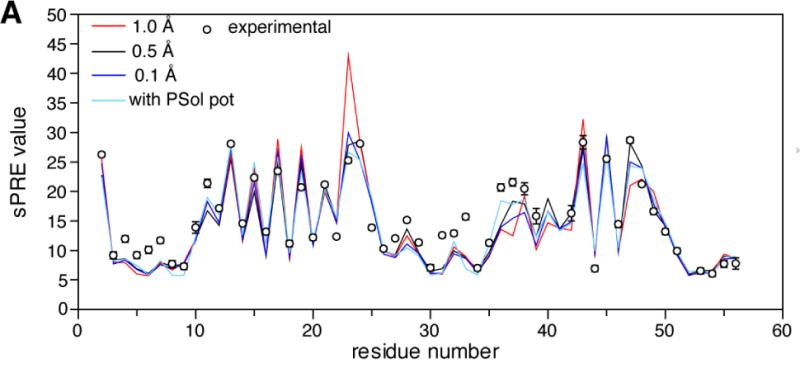

In [5]:
from IPython.display import Image
Image("nihms960013f2.jpg", )

 id   atoms in selection        obs     calc    diff  minDist


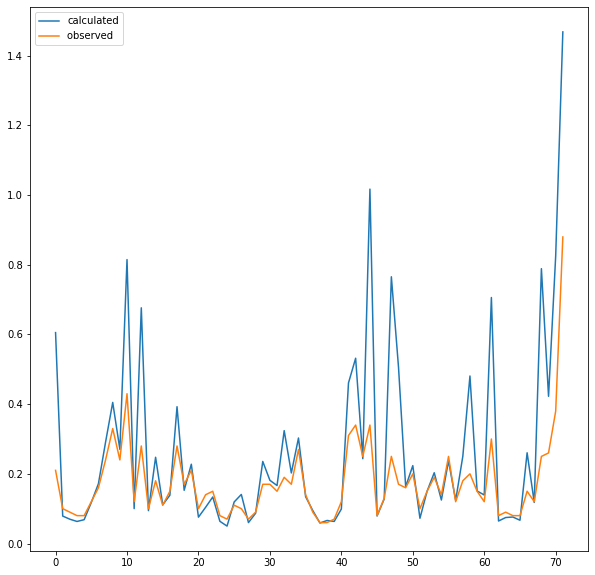

In [20]:
import matplotlib as mpl
import matplotlib.pyplot as plt
from simulationTools import analyze
import numpy as np

analyze(psol, outFilename="test_results.txt")

calc = []
obs = []
with open('test_results.txt', 'r') as f:
    lines = f.read().splitlines()
print(lines[6])
for line in lines[8:]:
    if line == '':
        break
    obs.append(float(line.split()[-4]))
    calc.append(float(line.split()[-3]))
    
plt.figure(figsize=(10,10))
plt.plot(np.array(calc) / 7, label='calculated')
plt.plot(np.array(obs), label='observed ')
plt.legend()

## Test 2: Provide empty strings to restraints

In [2]:
import protocol
radius = 1.4
protocol.loadPDB("test_pdb.pdb", deleteUnknownAtoms=True)

In [3]:
from psolPotTools import create_PSolPot
psol = create_PSolPot("psol")

In [4]:
psol.setRmin(0.8)
#psol.setRadMax(30.0)
#psol.setThkIni(1.0)
#psol.setThkFac(1.4)
#psol.setTcType("fix")
psol.setTauC(0.2)
#psol.setPconc(4.0)
psol.setSqn(3.5)
psol.setRho0(0.24)
psol.setScale(1.7)

psol.tessellation().setVerbose(True)

print(psol.info())
psol.setThreshold(0)
psol.setProbeRadius(radius)
psol.setRadiusOffset(radius)

print(psol.calcEnergy())

number of restraints_: 0
selection: known and not pseudo
simulation: XplorSimulation
threshold: 0.1
potential type: PSol
target type: gamma
 scale = 1.7
 hardExp = 2
 rSwitch = 10
 softExp = 2
 asympSlope = 0
 rmin = 0.8
 centerOffset = 0
 rho0 = 0.24
 freqI = 500 [MHz] 
 sqn = 3.5
 gfac = 2
 gammaI = 26.7522[10^7 T/s] 
 tauc = 0.2 [ns] FIXED

0.0


In [5]:
from simulationTools import testGradient

psol.tessellation().setVerbose(True)

#testGradient(psol) #,alwaysPrint=True)

from ivm import IVM
dyn=IVM()
protocol.torsionTopology(dyn)

protocol.initDynamics(dyn,
                      bathTemp=1000,
                      printInterval=5,
                      numSteps=10,
                      potList=[psol],
                      )

dyn.run()
                      
#testGradient(psol) #,alwaysPrint=True)

*--- Dynamics ---- step=      0 ---- time=         0 ---- delta_t=     0.001 --*
| E(kin)+E(poten)=         0.000 E(kin)=         0.000 temperature=      0.000 |
|   E(poten)=     0.0000000       grad=     0.0000000      psol=     0.0000000 |
*------------------------------------------------------------------------------*
*--- Dynamics ---- step=      5 ---- time=     0.005 ---- delta_t=     0.001 --*
| E(kin)+E(poten)=         0.000 E(kin)=         0.000 temperature=      0.000 |
|   E(poten)=     0.0000000       grad=     0.0000000      psol=     0.0000000 |
*------------------------------------------------------------------------------*
*--- Dynamics ---- step=     10 ---- time=      0.01 ---- delta_t=     0.001 --*
| E(kin)+E(poten)=         0.000 E(kin)=         0.000 temperature=      0.000 |
|   E(poten)=     0.0000000       grad=     0.0000000      psol=     0.0000000 |
*------------------------------------------------------------------------------*


1

In [6]:
from simulationTools import analyze

analyze(psol)


  Violated PSol restraints in potential term: psol

 id   atoms in selection        obs     calc    diff  minDist
--------------------------------------------------------------------------

number of restraints_: 0
selection: known and not pseudo
simulation: XplorSimulation
threshold: 0
potential type: PSol
target type: gamma
 scale = 1.7
 hardExp = 2
 rSwitch = 10
 softExp = 2
 asympSlope = 0
 rmin = 0.8
 centerOffset = 0
 rho0 = 0.24
 freqI = 500 [MHz] 
 sqn = 3.5
 gfac = 2
 gammaI = 26.7522[10^7 T/s] 
 tauc = 0.2 [ns] FIXED



'------------------------------------------------------------\nsummary    Name       Energy      RMS     Violations\nsummary total            0.00               0.0\nsummary psol             0.00               0.0\n------------------------------------------------------------\n Solvent PRE Analysis\nPSol               RMS   corr.    Q-fac   tau_c  Viols\nPSol psol          nan     nan      nan   0.200     0\n------------------------------------------------------------\n'

## Test 3: Vary restraints and check if the calc values change.

In [2]:
import protocol
radius = 1.4
protocol.loadPDB("test_pdb.pdb", deleteUnknownAtoms=True)

In [3]:
from psolPotTools import create_PSolPot
with open('test_spre.tbl', 'r') as f:
    lines = f.read().splitlines()
new_lines = []
for line in lines:
    new_line = line[:32]
    new_line += '0.00 0.01'
    new_lines.append(new_line)
new_lines = '\n'.join(new_lines)
psol = create_PSolPot("psol", restraints=new_lines)

In [4]:
psol.setRmin(0.8)
#psol.setRadMax(30.0)
#psol.setThkIni(1.0)
#psol.setThkFac(1.4)
#psol.setTcType("fix")
psol.setTauC(0.2)
#psol.setPconc(4.0)
psol.setSqn(3.5)
psol.setRho0(0.24)
psol.setScale(1.7)

psol.tessellation().setVerbose(True)

print(psol.info())
psol.setThreshold(0)
psol.setProbeRadius(radius)
psol.setRadiusOffset(radius)

print(psol.calcEnergy())

number of restraints_: 72
selection: known and not pseudo
simulation: XplorSimulation
threshold: 0.1
potential type: PSol
target type: gamma
 scale = 1.7
 hardExp = 2
 rSwitch = 10
 softExp = 2
 asympSlope = 0
 rmin = 0.8
 centerOffset = 0
 rho0 = 0.24
 freqI = 500 [MHz] 
 sqn = 3.5
 gfac = 2
 gammaI = 26.7522[10^7 T/s] 
 tauc = 0.2 [ns] FIXED

879.6233163197418


Text(0.5, 1.0, 'monoUb PSolPot')

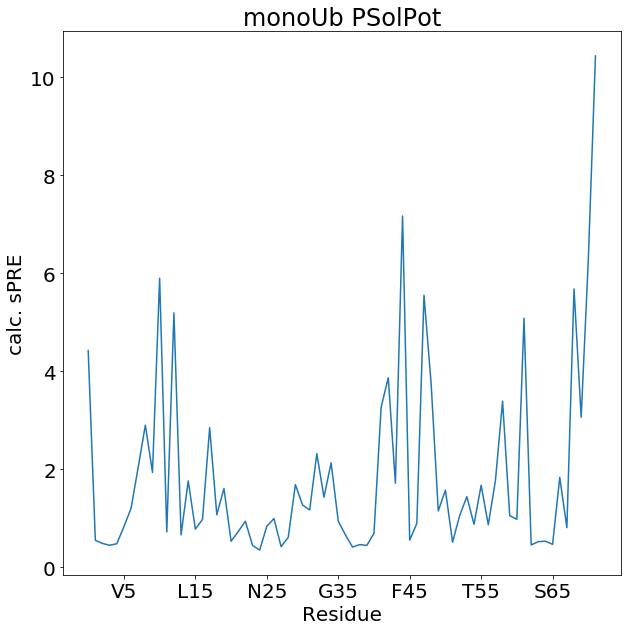

In [6]:
# test = [4.4215548641418945, 0.5506983051887334, 0.4857579690610159, 0.4488616512737301, 0.47938275298999966]

values = []
for r in psol.restraints():
    values.append(r.calcd())
    
font = {'family' : 'normal',
        'weight' : 'normal',
        'size'   : 20}
mpl.rc('font', **font)

labels = ['V5', 'L15', 'N25', 'G35', 'F45', 'T55', 'S65']
tickpos = [5, 15, 25, 35, 45, 55, 65]

plt.figure(figsize=(10,10))
plt.plot(np.array(values))
ax = plt.gca()
ax.set_xticks(tickpos)
ax.set_xticklabels(labels)
ax.set_xlabel("Residue")
ax.set_ylabel("calc. sPRE")
ax.set_title("monoUb PSolPot")
# plt.legend()

# Do some dynamics with both combined

# Run on custered K6-diUbi

## Set up fake table

In [19]:
with open("test_spre.tbl", 'r') as f:
    lines = f.read().splitlines()
    
new_lines = []
for i, line in enumerate(lines):
    new_lines.append(line)
for line in lines:
    old_num = line[14:16]
    i = int(old_num)
    new_num = f"{i + 76}"
    line = line.replace(old_num, new_num)
    new_lines.append(line)
    
with open("diUbi_fake_spre.tbl", 'w') as f:
    for l in new_lines:
        f.write(l + '\n')

## Use Data from Tobias Schneider

In [3]:
def label(resSeq, sPRE):
    return f"assign (resid {resSeq:<2} and name HN)	{sPRE:5.3f} 0.01"
    
file = "solventPRE_NMR_data/sPRE values K6 dimer proximal.txt"
new_lines = []
with open(file, 'r') as f:
    lines = f.read().splitlines()
this = {}
this['name'] = os.path.basename(file).split('.')[0].replace(' ', '_')
this['labels'] = []
this['x'] = []
this['y'] = []
this['y_err'] = []
for i, l in enumerate(lines):
    if 'primary' in l or 'mM' in l:
        continue
    datafields = l.split()
    if len(datafields) == 0:
        continue
    if len(datafields) == 1 or '--' in datafields:
        this['labels'].append(datafields[0])
        this['x'].append(i)
        this['y'].append(0)
        this['y_err'].append(0)
    else:
        this['labels'].append(datafields[0])
        this['x'].append(i)
        this['y'].append(float(datafields[1]))
        this['y_err'].append(float(datafields[2]))
for i, j in zip(this['labels'], this['y']):
    if int(i[3:]) == 6: # drop proximal lysine which is LYQ in pdb file.
        continue
    i = i[3:]
    new_lines.append(label(i, j))
    
file = "solventPRE_NMR_data/sPRE values K6 dimer distal.txt"
with open(file, 'r') as f:
    lines = f.read().splitlines()
this = {}
this['name'] = os.path.basename(file).split('.')[0].replace(' ', '_')
this['labels'] = []
this['x'] = []
this['y'] = []
this['y_err'] = []
for i, l in enumerate(lines):
    if 'primary' in l or 'mM' in l:
        continue
    datafields = l.split()
    if len(datafields) == 0:
        continue
    if len(datafields) == 1 or '--' in datafields:
        this['labels'].append(datafields[0])
        this['x'].append(i)
        this['y'].append(0)
        this['y_err'].append(0)
    else:
        this['labels'].append(datafields[0])
        this['x'].append(i)
        this['y'].append(float(datafields[1]))
        this['y_err'].append(float(datafields[2]))
for i, j in zip(this['labels'], this['y']):
    i = int(i[3:]) + 76
    new_lines.append(label(i, j))
    
with open("diUbi_spre.tbl", 'w') as f:
    for l in new_lines:
        f.write(l + '\n')

## Iterate

In [6]:
# Save default values

# default_xplor_envs = {}

# for key, value in os.environ.items():
#     if any(['xplor' in x.lower() for x in (key, value)]) or any(['psol' in x.lower() for x in (key, value)]):
#         default_xplor_envs[key] = value
        
# with open('xplor_default_envs.json', 'w') as fp:
#     json.dump(default_xplor_envs, fp)

In [13]:
def delete_xplor_envs():
    for key, value in os.environ.items():
        if any(['xplor' in x.lower() for x in (key, value)]) or any(['psol' in x.lower() for x in (key, value)]):
            del os.environ[key]
            
    with open("xplor_default_envs.json", 'r') as f:
        new_values = json.load(f)
    os.environ.update(new_values)
    
delete_xplor_envs()

In [1]:
import numpy as np
import matplotlib as mpl
import matplotlib.pyplot as plt
import glob, sys, re, os, shutil, json
%load_ext autoreload
%autoreload 2

In [2]:
i = 0
for directory in glob.glob("/home/kevin/projects/tobias_schneider/CA_distances_cluster_trajs/*/"):
    for file in glob.glob(f"{directory}*.pdb"):
        print(file)
        if 'protocol' in globals():
            del protocol
        import protocol
        radius = 1.4
        protocol.loadPDB(file, deleteUnknownAtoms=True)
        from psolPotTools import create_PSolPot
        
        with open("diUbi_empty_spre.tbl", 'r') as f:
            lines = f.read().splitlines()
        lines = '\n'.join(lines)
        psol = create_PSolPot(f"psol_{i}", restraints=lines)
        
        # psol options
        psol.setRmin(0.8)
        #psol.setRadMax(30.0)
        #psol.setThkIni(1.0)
        #psol.setThkFac(1.4)
        #psol.setTcType("fix")
        psol.setTauC(0.2)
        #psol.setPconc(4.0)
        psol.setSqn(3.5)
        psol.setRho0(0.24)
        psol.setScale(1.7)

        psol.tessellation().setVerbose(True)

        print(psol.info())
        psol.setThreshold(0)
        psol.setProbeRadius(radius)
        psol.setRadiusOffset(radius)

        print(psol.calcEnergy())
        values = []
        for r in psol.restraints():
            values.append(r.calcd())
        i += 1
        break
    break

/home/kevin/projects/tobias_schneider/CA_distances_cluster_trajs/cluster_0/cluster_0_frame_0.pdb
number of restraints_: 142
selection: known and not pseudo
simulation: XplorSimulation
threshold: 0.1
potential type: PSol
target type: gamma
 scale = 1.7
 hardExp = 2
 rSwitch = 10
 softExp = 2
 asympSlope = 0
 rmin = 0.8
 centerOffset = 0
 rho0 = 0.24
 freqI = 500 [MHz] 
 sqn = 3.5
 gfac = 2
 gammaI = 26.7522[10^7 T/s] 
 tauc = 0.2 [ns] FIXED

1550.1186104102949


In [5]:
values

[2.4762634873182434,
 0.5181306376726953,
 0.4542247235955527,
 0.38178741287572115,
 0.3619879512293279,
 1.1623793799571382,
 0.6941855387340136,
 1.4630458716774604,
 9.366791863119985,
 5.619337518734662,
 3.8145610616910575,
 0.6510479308717263,
 2.8339886664297635,
 0.49942584767647635,
 3.5580339914062544,
 0.9847258685070773,
 4.457517720267651,
 2.1037785076023323,
 1.4993623024392446,
 3.0979180327753135,
 0.4701206601508476,
 0.5837508034896632,
 1.169147589118163,
 0.436569982175259,
 0.31049015374126676,
 0.956001190866425,
 1.202233409824553,
 0.400045712524509,
 0.5765736011773899,
 2.046277918041769,
 1.2981910956366554,
 0.9656755177199847,
 3.3979549228004933,
 1.4326370578040248,
 3.910928021544505,
 1.3005061685735788,
 0.5690340933537181,
 0.2835463600227279,
 0.28863132624848464,
 0.21435866652915248,
 0.48891871790926394,
 1.5572852131299126,
 1.2657088249284725,
 1.2590403735802502,
 4.107833221234311,
 0.38695993151561947,
 0.7413590983062651,
 1.62357395356205

# Test standalone program

Install : tar xjvf sPRE.tar.bz2; chmod a+x sPRE.x

Usage : ./sPRE.x (pdb file) (Rprobe) (Dpara) (Atom)

Rprobe: the size of paramagnetic probe

Dpara : the concentricity of paramagnetic center, 0 means right at the center

Atom : the name of atom used for sPRE calculation, which will list in the third column of the output. 'HM' represents protons of methyl group

In [6]:
import subprocess
import matplotlib as mpl
import matplotlib.pyplot as plt
import numpy as np

No handles with labels found to put in legend.


findfont: Font family ['normal'] not found. Falling back to DejaVu Sans.
findfont: Font family ['normal'] not found. Falling back to DejaVu Sans.


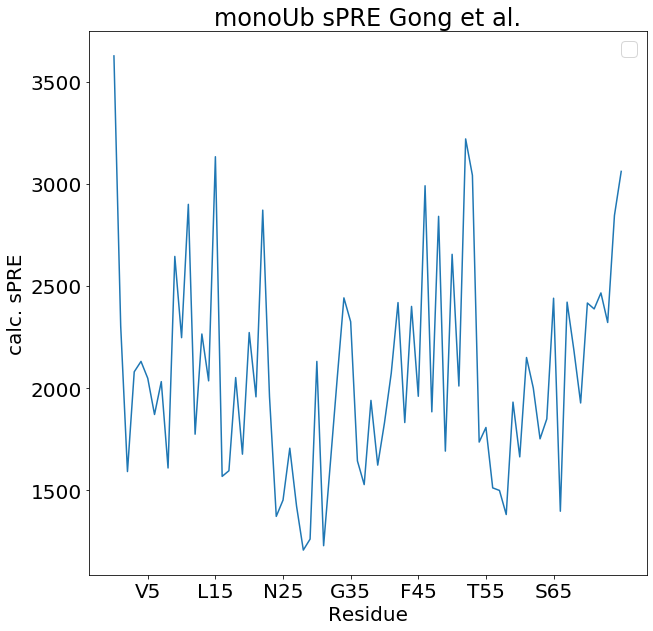

In [7]:
filename = "test_pdb.pdb"
Rprobe = 40
Dpara = 0
Atom = 'N'
cmd = f"./sPRE.x {filename} {Rprobe} {Dpara} {Atom}"

proc = subprocess.Popen(cmd , stdin=subprocess.PIPE, stdout=subprocess.PIPE, stderr=subprocess.PIPE, shell=True)
out_proc = proc.stdout.read().decode('utf-8')
err_proc = proc.stderr.read().decode('utf-8')
# print(out_proc)
# print(err_proc)

font = {'family' : 'normal',
        'weight' : 'normal',
        'size'   : 20}

mpl.rc('font', **font)

labels = ['V5', 'L15', 'N25', 'G35', 'F45', 'T55', 'S65']
tickpos = [5, 15, 25, 35, 45, 55, 65]

values = list(map(lambda x: float(x.split()[1]), out_proc.splitlines()))
plt.figure(figsize=(10,10))
plt.plot(np.array(values))
ax = plt.gca()
ax.set_xticks(tickpos)
ax.set_xticklabels(labels)
ax.set_xlabel("Residue")
ax.set_ylabel("calc. sPRE")
ax.set_title("monoUb sPRE Gong et al.")
plt.legend()

##